In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import sys

from matplotlib import pyplot as plt

: 

In [2]:
sys.path.append('/root/rag-experiment')
print(sys.path)

['/root/envs/eval/lib/python311.zip', '/root/envs/eval/lib/python3.11', '/root/envs/eval/lib/python3.11/lib-dynload', '', '/root/envs/eval/lib/python3.11/site-packages', '/root/rag-experiment']


In [3]:
DATASETS = ["scifact", "nfcorpus", "arguana", "trec-covid", "fiqa"]
PATH = "rag-experiment/eval/"
K = [3, 5, 10, 50, 100, 1000]

In [4]:
def get_cka_results(path:str, dataset: str, num_embeds: int = 0, chunk_size: int = 256, num_queries: int = 25,
                    baseline: bool = False):
    mc = "_base" if baseline else ""
    file_name = f"{dataset}_{chunk_size}_{num_embeds}_{num_queries}_top1{mc}_cka.csv"
    return pd.read_csv(path +  file_name, index_col=0)

def get_nn_results(path:str, dataset: str, metric:str, k: int, num_embeds: int = 0, chunk_size: int = 256,
                   num_queries: int = 25, baseline: bool = False):
    mc = "_base" if baseline else "_"
    file_name = f"{dataset}_{chunk_size}_{num_embeds}_{num_queries}_top{k}{mc}{metric}.csv"
    return pd.read_csv(path +  file_name, index_col=0)

In [5]:
ckas = []
stacked = None

for dataset in DATASETS:
    df = get_cka_results(PATH, dataset)
    ckas.append(df)

    if stacked is None:
        stacked = df
    else:
        stacked = pd.concat((stacked, df))

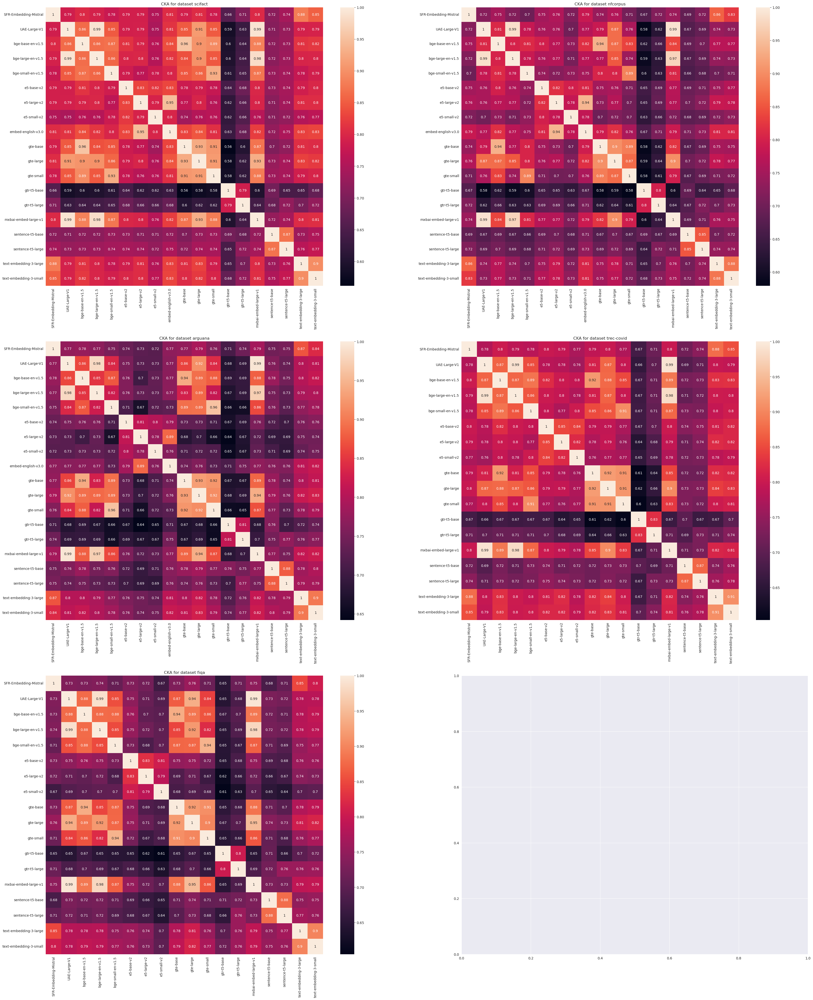

In [6]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for num, dataset in enumerate(DATASETS):
    col = num % 2
    row = num // 2
    sns.heatmap(data=ckas[num], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'CKA for dataset {dataset}')

plt.show()

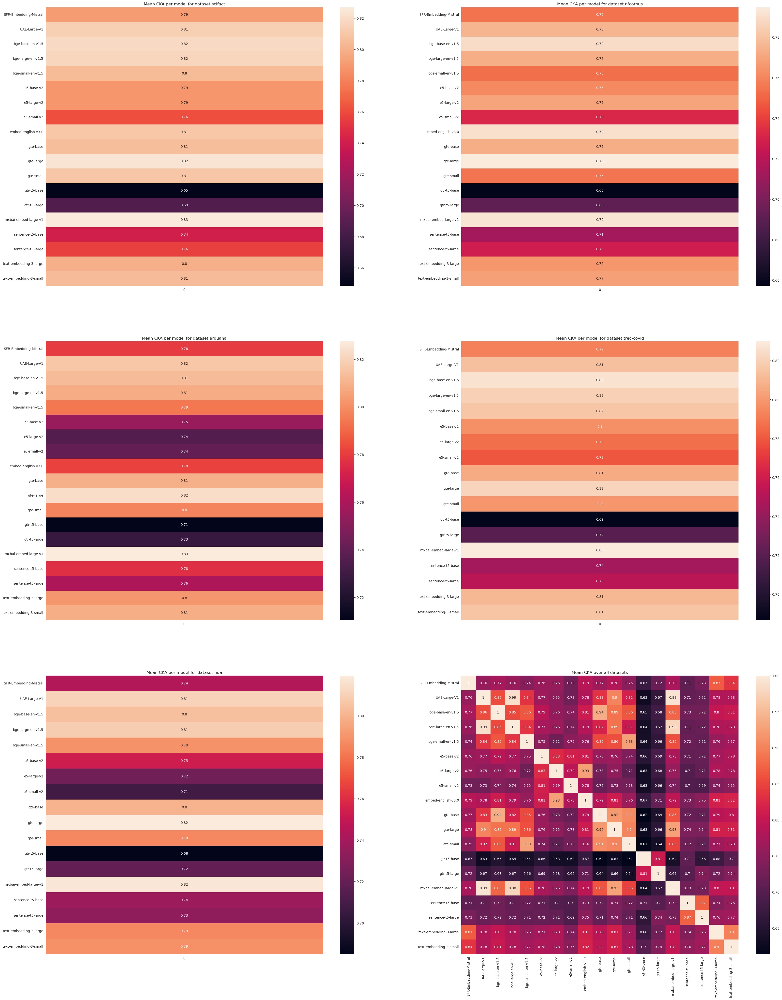

In [7]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for num, dataset in enumerate(DATASETS):
    col = num % 2
    row = num // 2
    sns.heatmap(data=np.array(ckas[num].mean(axis=1)).reshape(-1, 1), ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Mean CKA per model for dataset {dataset}')
    ax[row][col].plot()
    ax[row][col].set_yticklabels(ckas[num].index, rotation=0)

sns.heatmap(data=stacked.groupby(level=0, sort=False).mean(), ax=ax[2][1], annot=True)
ax[2][1].set_title('Mean CKA over all datasets')
plt.show()

In [8]:
jaccard = {}
rank = {}

for dataset in DATASETS:
    jaccard[dataset], rank[dataset] = [], []
    for k in K:
        jaccard[dataset].append(get_nn_results(PATH, dataset, 'jaccard', k))
        rank[dataset].append(get_nn_results(PATH, dataset, 'rank', k))

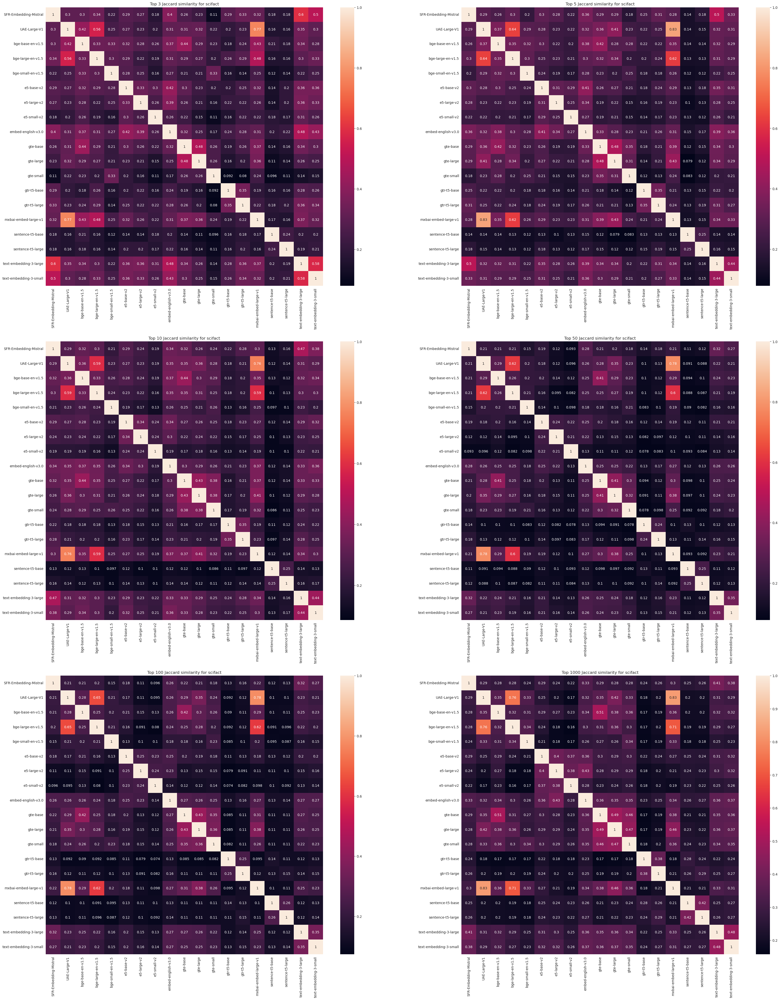

In [9]:
jaccard_scifact = jaccard["scifact"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=jaccard_scifact[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} Jaccard similarity for scifact')

plt.show()

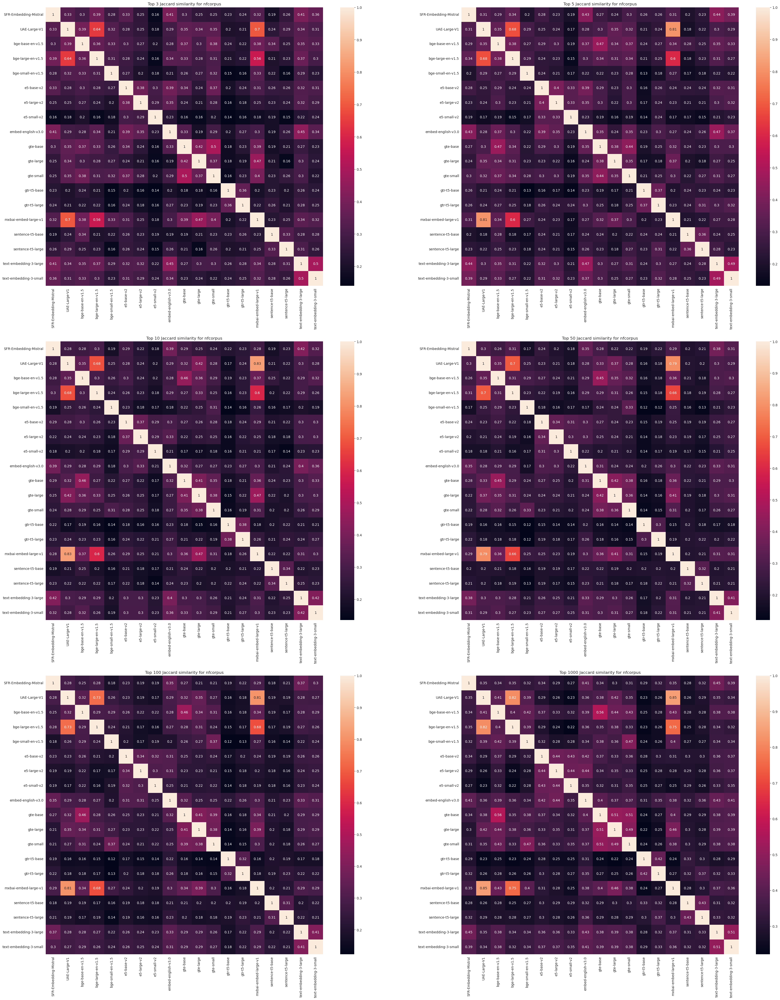

In [10]:
jaccard_nfcorpus = jaccard["nfcorpus"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=jaccard_nfcorpus[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} Jaccard similarity for nfcorpus')

plt.show()

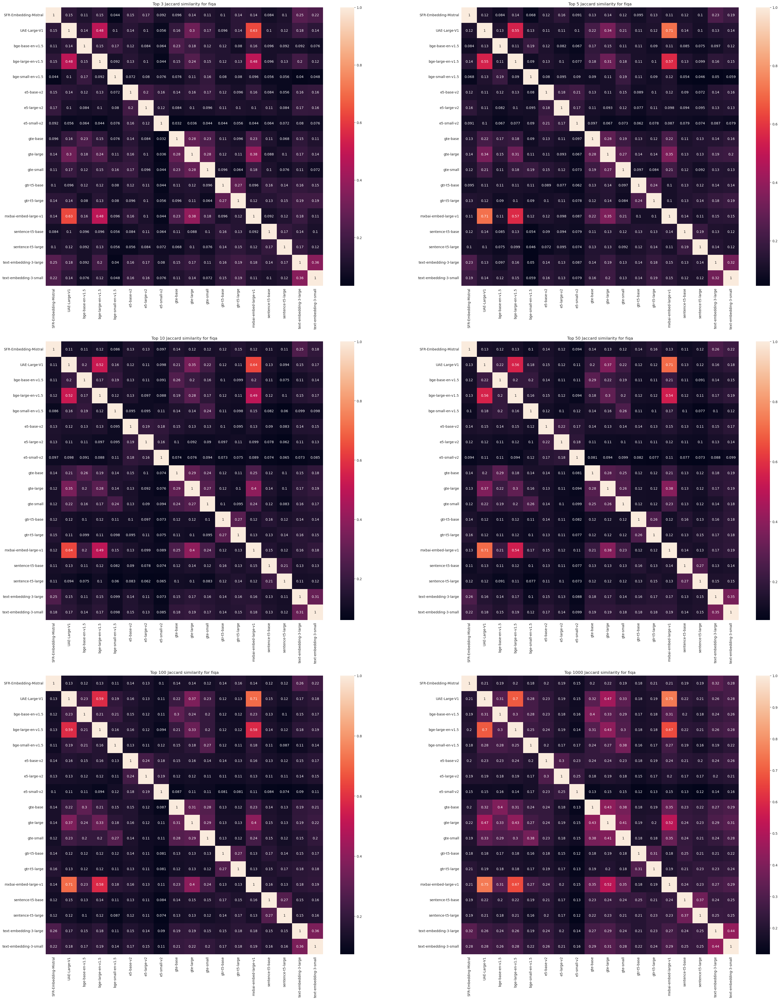

In [11]:
jaccard_fiqa = jaccard["fiqa"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=jaccard_fiqa[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} Jaccard similarity for fiqa')

plt.show()

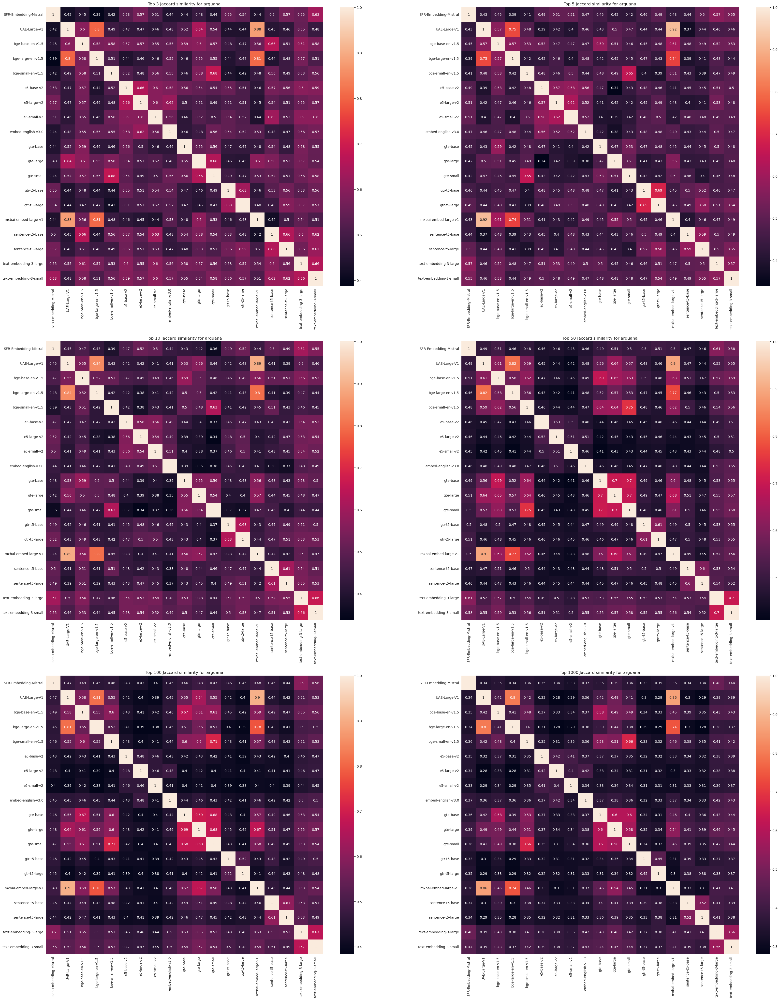

In [12]:
jaccard_arguana = jaccard["arguana"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=jaccard_arguana[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} Jaccard similarity for arguana')

plt.show()

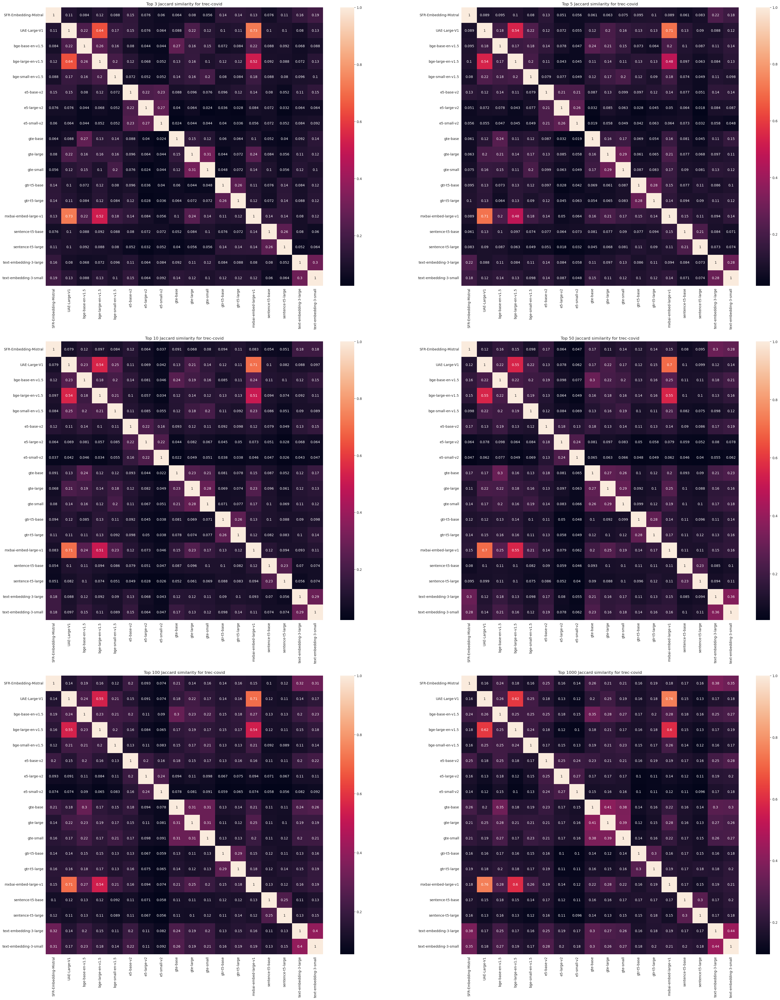

In [13]:
jaccard_covid = jaccard["trec-covid"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=jaccard_covid[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} Jaccard similarity for trec-covid')

plt.show()

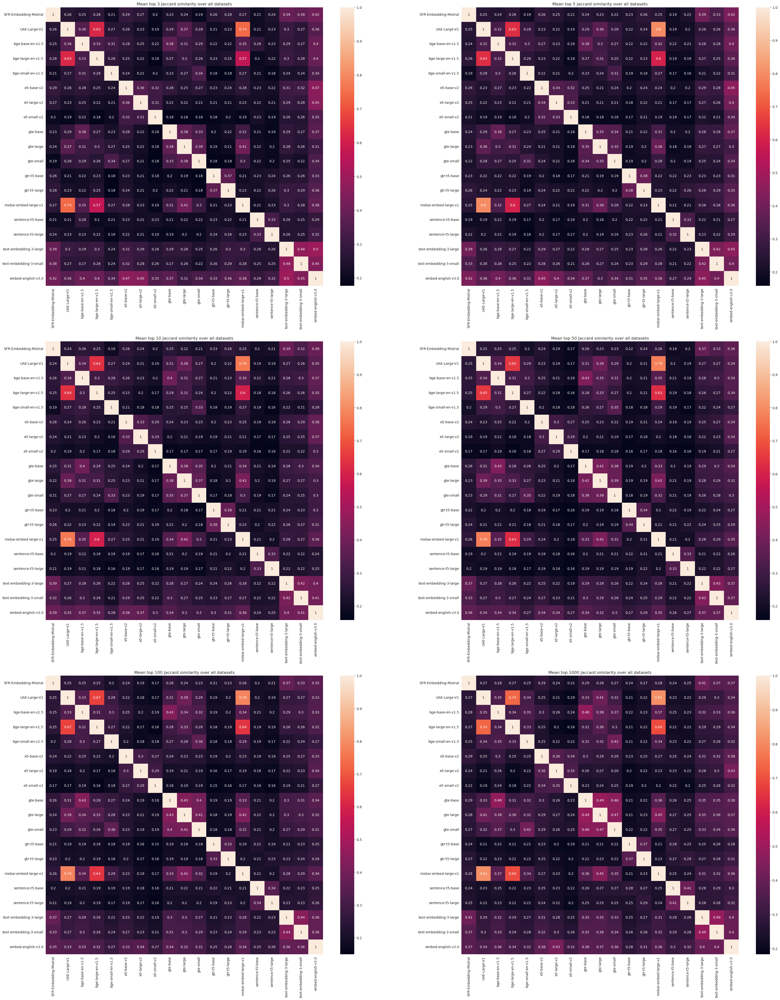

In [14]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    df = None
    for dataset in DATASETS:
        if df is None:
            df = jaccard[dataset][idx]
        else:
            df = pd.concat((jaccard[dataset][idx], df))
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=df.groupby(level=0, sort=False).mean(), ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Mean top {k} Jaccard similarity over all datasets')

plt.show()

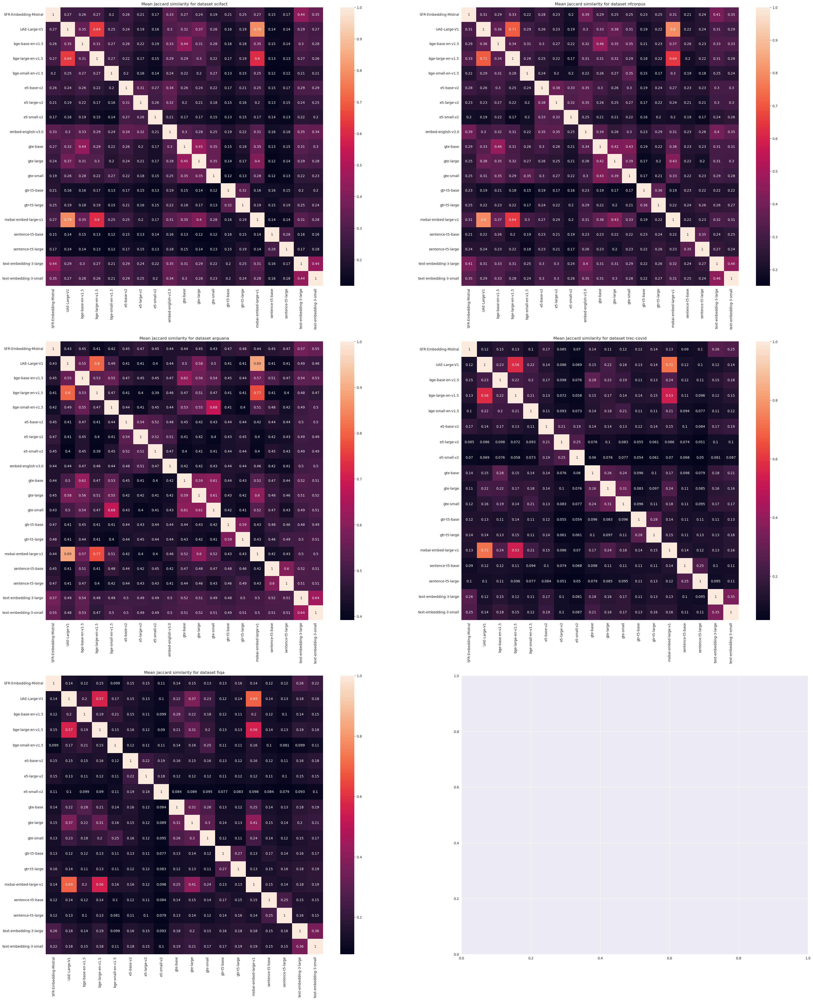

In [15]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for num, dataset in enumerate(DATASETS):
    df = None
    for idx, k in enumerate(K):
        if df is None:
            df = jaccard[dataset][idx]
        else:
            df = pd.concat((jaccard[dataset][idx], df))
    col = num % 2
    row = num // 2
    sns.heatmap(data=df.groupby(level=0, sort=False).mean(), ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Mean Jaccard similarity for dataset {dataset}')

plt.show()

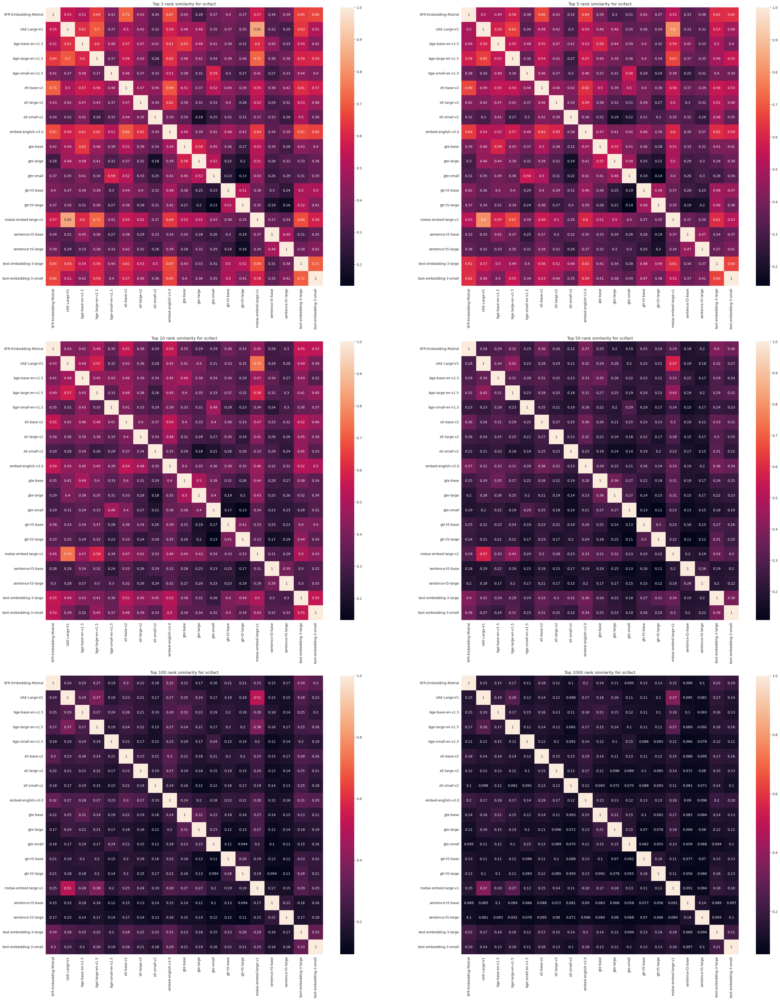

In [16]:
rank_scifact = rank["scifact"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=rank_scifact[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} rank similarity for scifact')

plt.show()

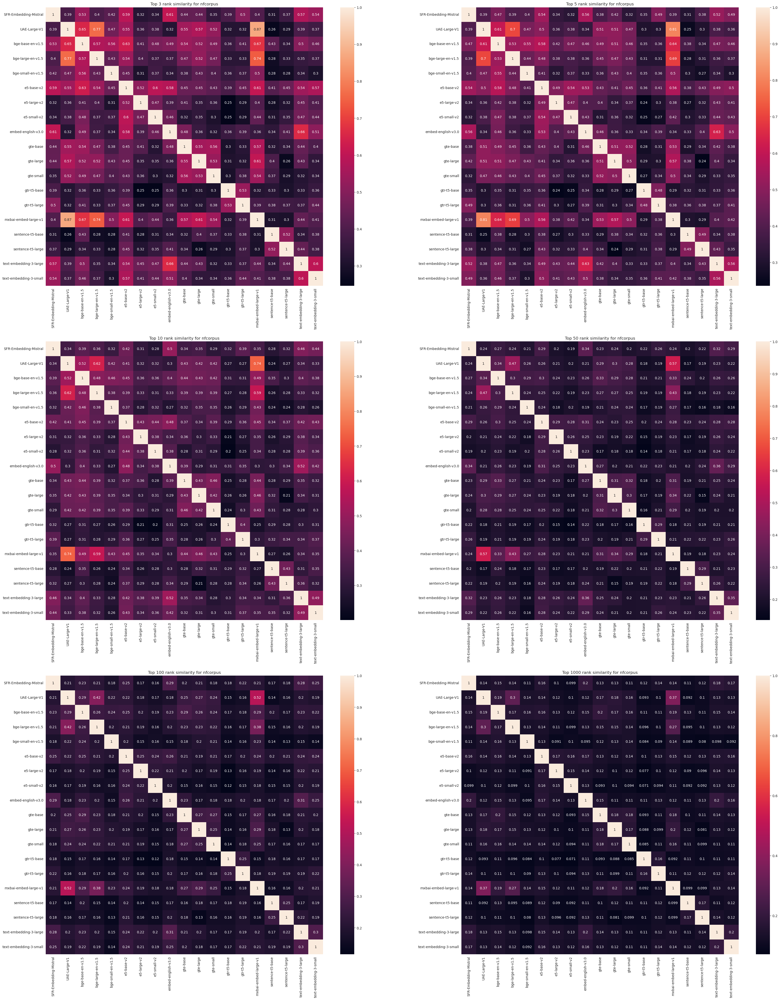

In [17]:
rank_nfcorpus = rank["nfcorpus"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=rank_nfcorpus[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} rank similarity for nfcorpus')

plt.show()

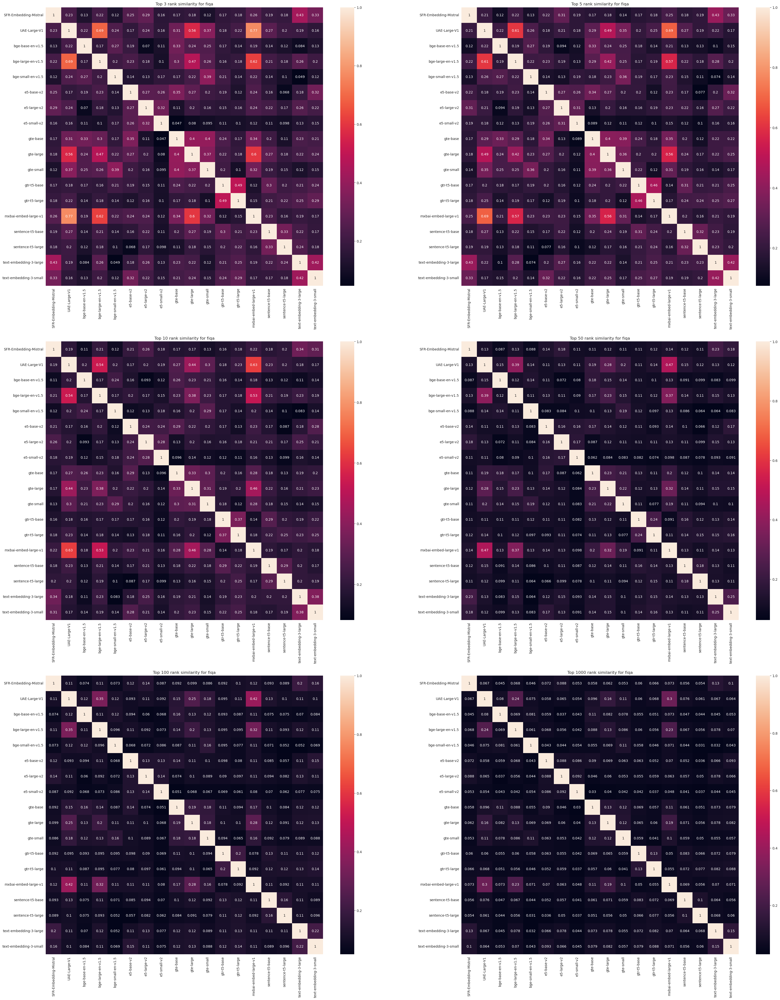

In [18]:
rank_fiqa = rank["fiqa"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=rank_fiqa[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} rank similarity for fiqa')

plt.show()

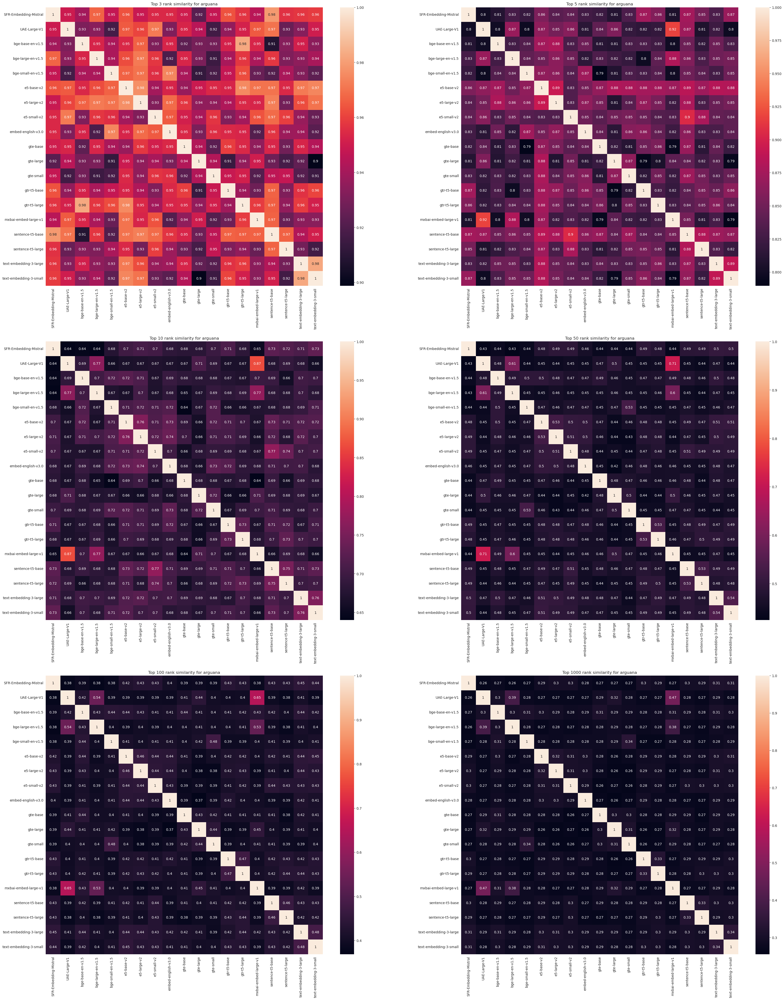

In [19]:
rank_arguana = rank["arguana"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=rank_arguana[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} rank similarity for arguana')

plt.show()

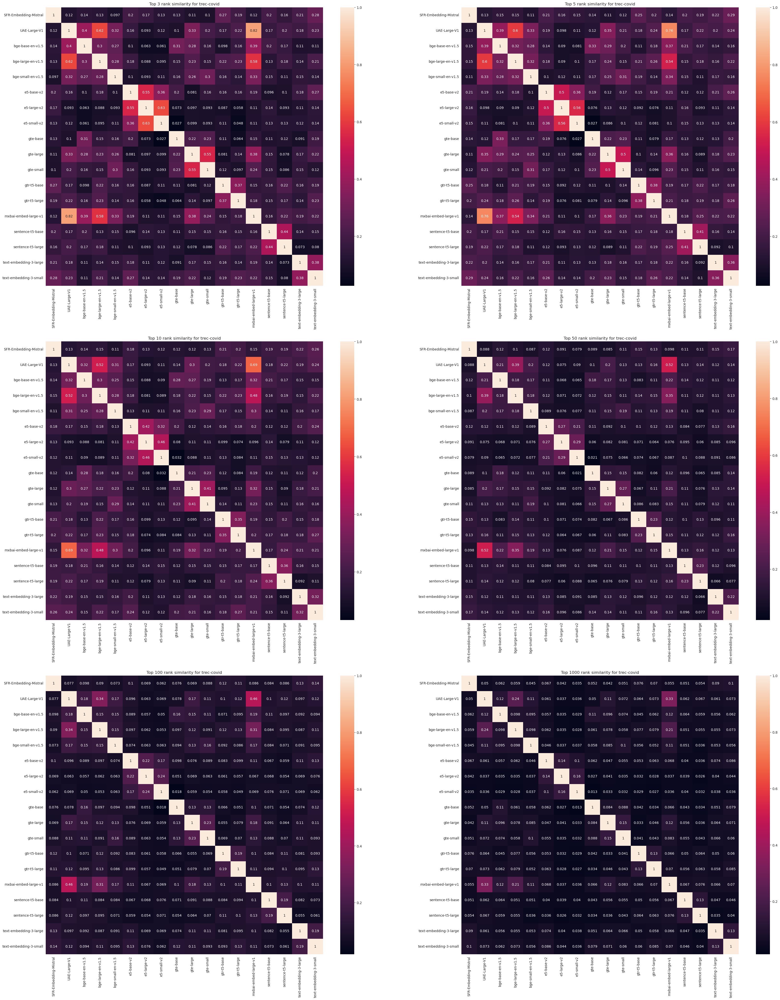

In [20]:
rank_covid = rank["trec-covid"]

fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=rank_covid[idx], ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Top {k} rank similarity for trec-covid')

plt.show()

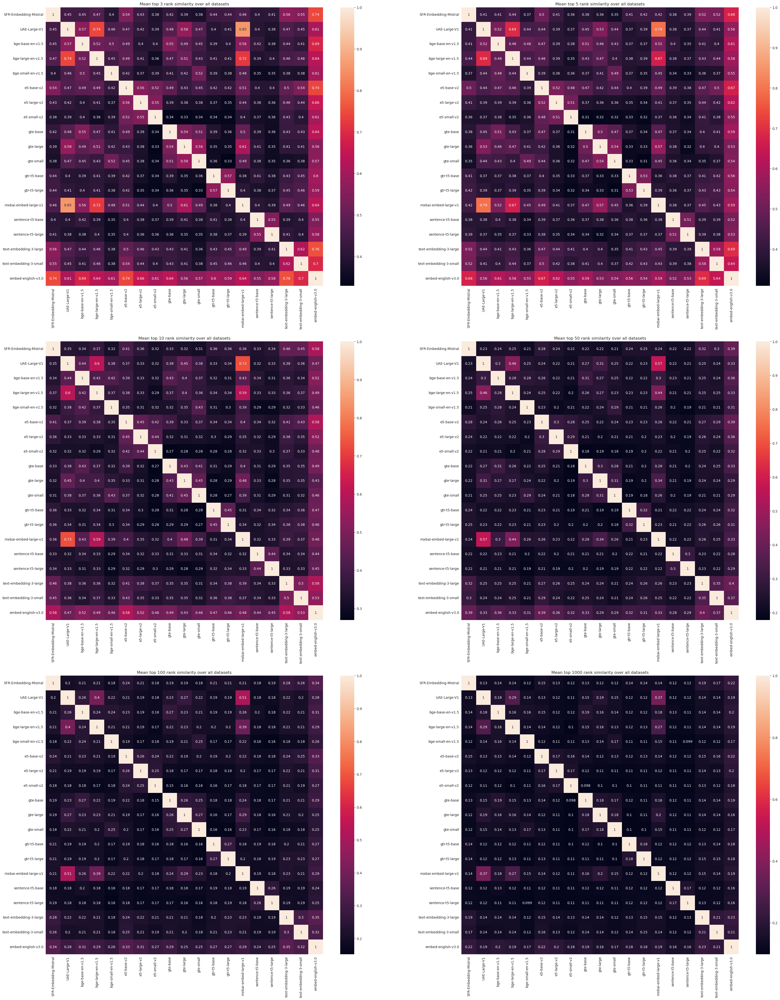

In [21]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for idx, k in enumerate(K):
    df = None
    for dataset in DATASETS:
        if df is None:
            df = rank[dataset][idx]
        else:
            df = pd.concat((rank[dataset][idx], df))
    col = idx % 2
    row = idx // 2
    sns.heatmap(data=df.groupby(level=0, sort=False).mean(), ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Mean top {k} rank similarity over all datasets')

plt.show()

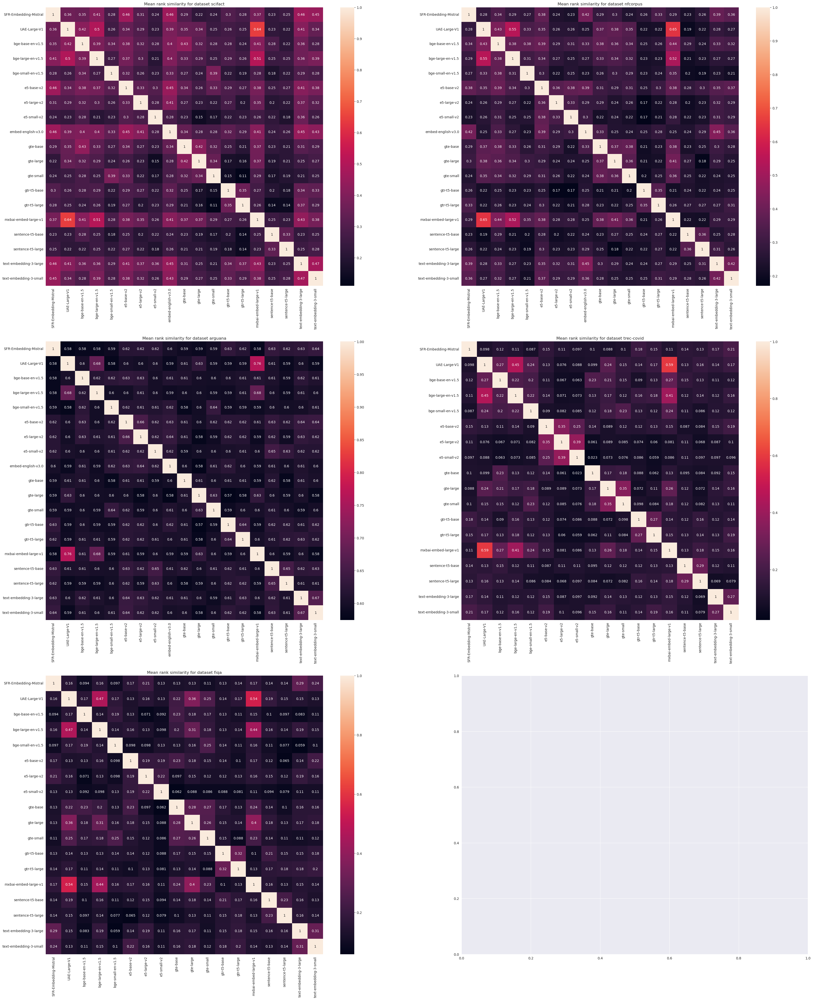

In [22]:
fig, ax = plt.subplots(3, 2, figsize=(40,50))

for num, dataset in enumerate(DATASETS):
    df = None
    for idx, k in enumerate(K):
        if df is None:
            df = rank[dataset][idx]
        else:
            df = pd.concat((rank[dataset][idx], df))
    col = num % 2
    row = num // 2
    sns.heatmap(data=df.groupby(level=0, sort=False).mean(), ax=ax[row][col], annot=True)
    ax[row][col].set_title(f'Mean rank similarity for dataset {dataset}')

plt.show()

In [23]:
MODELS = ['SFR-Embedding-Mistral', 'UAE-Large-V1', 'bge-base-en-v1.5', 'bge-large-en-v1.5', 'bge-small-en-v1.5',
          'e5-base-v2', 'e5-large-v2', 'e5-small-v2', 'embed-english-v3.0', 'gte-base', 'gte-large', 'gte-small',
          'gtr-t5-base', 'gtr-t5-large', 'mxbai-embed-large-v1', 'sentence-t5-base', 'sentence-t5-large',
          'text-embedding-3-large', 'text-embedding-3-small']
MODEL = 'gte-large'
DATASETS = ["nfcorpus"]
mistral = {}

for model in MODELS:
    if model != MODEL:
        inner_dict = {}
        for dataset in DATASETS:
            if dataset not in ["trec-covid", "fiqa"] or model != 'embed-english-v3.0':
                inner_dict[dataset] = []
        mistral[model] = inner_dict

for i in range(6509):
    for dataset in DATASETS:
        df = get_nn_results(PATH, dataset, 'jaccard', i + 1)
        for model in MODELS:
            if model != MODEL:
                if dataset not in ["trec-covid", "fiqa"] or model != 'embed-english-v3.0':
                    mistral[model][dataset].append(df[MODEL][model])

In [24]:
fig, ax = plt.subplots(layout='constrained', figsize=(20, 20))
plt.rc('xtick', labelsize=30)
plt.rc('ytick', labelsize=30)

colors = ['black', 'darkgrey', 'red', 'darkorange', 'fuchsia', 'gold', 'darkkhaki', 'yellowgreen', 'darkolivegreen',
          'cyan', 'dodgerblue', 'deeppink', 'purple', 'plum', 'sienna', 'yellow', 'lime', 'navy']

for idx, entry in enumerate(mistral):
    ax.plot([i+1 for i in range(6509)], mistral[entry]["nfcorpus"], label=f"{MODEL}_vs_{entry}", color=colors[idx])

ins = ax.inset_axes([0.6, 0.05, 0.4, 0.35], xlim=(0, 50), ylim=(0, 0.6))

for idx, entry in enumerate(mistral):
    ins.plot([i+1 for i in range(50)], mistral[entry]["nfcorpus"][0:50], color=colors[idx])

ins.set_facecolor('white')
ins.spines['bottom'].set_color('black')
ins.spines['left'].set_color('black')
ax.set_facecolor('white')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')
legend = fig.legend(loc='outside upper center', fontsize=23, mode='expand', ncols=2)
legend.get_frame().set_facecolor('white')
plt.savefig(f'jaccard_{MODEL}.pdf', bbox_inches='tight')
plt.close()